Authors:
- Abdulaziz Alakooz : Github([@3koozy](https://github.com/3koozy)).
- Ahad Algrais : Github([@ahadalgrais](https://github.com/ahadalgrais)).
- Mujtaba Alghadeer : Github([@ghadeem](https://github.com/ghadeem)).

In [ ]:
#Prequistites:
! pip install radiant_mlhub
! pip install torchgeo

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.1/52.1 KB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.4/137.4 KB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 KB 5.2 MB/s eta 0:00:00
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.65.0
    Uninstalling tqdm-4.65.0:
      Successfully uninstalled tqdm-4.65.0
  Attempting uninstall: shapely
    Found existing installation: shapely 2.0.1
    Uninstalling shapely-2.0.1:
      Successfully uninstalled shapely-2.0.1
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.7
    Uninstalling pydantic-1.10.7:
      Successfully uninstalled pydantic-1.10.7
Looking in indexes: https://pypi.o

In [ ]:
#Import needed libraries:
from radiant_mlhub import Dataset
import tempfile
import os
from pathlib import Path
from glob import glob

from tqdm.notebook import tqdm
import tifffile as tiff
import matplotlib.pyplot as plt
import numpy as np
from skimage import exposure

import torch
import torchvision
from PIL import Image
import torchvision.transforms as transforms
import segmentation_models_pytorch as smp
from matplotlib.colors import ListedColormap

from torch.utils.data import DataLoader
from torchgeo.datasets import RasterDataset, stack_samples, unbind_samples, NAIP, ChesapeakeDE
from torchgeo.datasets.utils import download_url
from torchgeo.samplers import RandomGeoSampler

%matplotlib inline

os.environ['MLHUB_API_KEY'] = 'f31d9911aff9a7ba88e4be73b25a41f960393cf31c5745da97b7f54bf31a1f62'

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
!nvidia-smi

Tue Mar 28 17:22:10 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8    10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Pre-processed Satalite datasets:

## 1- Radient ML-Hub:

In [ ]:
# fetch all availble datasets , then print first 5:
datasets = Dataset.list()
print(len(datasets))
for dataset in datasets[0:5]:
    print(dataset)

65
umd_mali_crop_type: 2019 Mali CropType Training Data
idiv_asia_crop_type: A crop type dataset for consistent land cover classification in Central Asia
dlr_fusion_competition_germany: A Fusion Dataset for Crop Type Classification in Germany
ref_fusion_competition_south_africa: A Fusion Dataset for Crop Type Classification in Western Cape, South Africa
ref_agrifieldnet_competition_v1: AgriFieldNet Competition Dataset


In [ ]:
#fetch specific dataset by it ID:
dataset = Dataset.fetch('ref_african_crops_kenya_02')
print(dataset)

#print datasets collections:
print('Collections:')
for collection in dataset.collections:
    print(f'* {collection.id}')

#check dataset size before download:
print("Catalog Size: ",dataset.stac_catalog_size)
print("Estimated Dataset Size: ", dataset.estimated_dataset_size)

ref_african_crops_kenya_02: CV4A Kenya Crop Type Competition
Collections:
* ref_african_crops_kenya_02_labels
* ref_african_crops_kenya_02_source
Catalog Size:  26875
Estimated Dataset Size:  16667676085


In [ ]:
#download selected dataset to local storage:
output_path = Path("./data/").resolve()
dataset.download(output_dir=output_path)

print('Done\n')

ref_african_crops_kenya_02: fetch stac catalog: 27KB [00:00, 192.13KB/s]                        
download assets: 100%|██████████| 685/685 [10:22<00:00,  1.10it/s]

Done



In [ ]:
# Define path to the source collection that was extracted from the dataset download in previous notebook
collection_path = Path('./data/ref_african_crops_kenya_02/ref_african_crops_kenya_02_source')

In [ ]:
def load_file(img_path):
    """Takes a path to the download archive and the path within the archive to the image and returns a numpy array."""
    
    return tiff.imread(str(img_path))

In [ ]:
# Get a list of dates that an observation from Sentinel-2 is provided for from the downloaded imagery

tile_dates = dict()

def filter_tifs(name):
    return name.endswith('.tif')

for f in glob(str(collection_path / '**/*.json')):
    tif_path = Path(f)
    _, tile_id, tile_date = tif_path.parent.name.rsplit('_', 2)

    if tile_id not in tile_dates:
        tile_dates[tile_id] = set()

    tile_dates[tile_id].add(tile_date)

In [ ]:
#Display list of tiles and dates of capture:
for tile in sorted(tile_dates.keys()):
    print(f'Tile ID: {tile}')
    dates = sorted(list(tile_dates[tile]))
    print(f'Dates: {", ".join(dates)}')
    print('')

Tile ID: 00
Dates: 20190606, 20190701, 20190706, 20190711, 20190721, 20190805, 20190815, 20190825, 20190909, 20190919, 20190924, 20191004, 20191103

Tile ID: 01
Dates: 20190606, 20190701, 20190706, 20190711, 20190721, 20190805, 20190815, 20190825, 20190909, 20190919, 20190924, 20191004, 20191103

Tile ID: 02
Dates: 20190606, 20190701, 20190706, 20190711, 20190721, 20190805, 20190815, 20190825, 20190909, 20190919, 20190924, 20191004, 20191103

Tile ID: 03
Dates: 20190606, 20190701, 20190706, 20190711, 20190721, 20190805, 20190815, 20190825, 20190909, 20190919, 20190924, 20191004, 20191103



In [ ]:
# Create a list of all available bands
bands = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12', 'CLD']

In [ ]:
# Define sample file to load
tile = '02'
date_ = '20190825'
band = 'B03'

archive_path = "./data/ref_african_crops_kenya_02_source.tar.gz"
img_path = collection_path / f"ref_african_crops_kenya_02_tile_{tile}_{date_}/{band}.tif"
band_data = load_file(img_path)

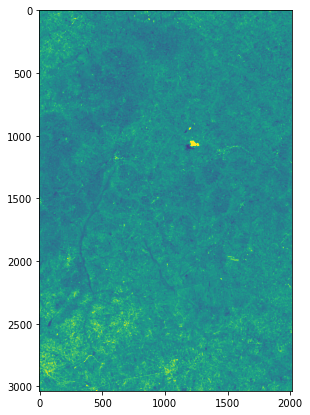

In [ ]:
# Plot sample image
fig = plt.figure(figsize=(7, 7))
plt.imshow(band_data, vmin=0, vmax=0.15)

In [ ]:
#fetch a timeseries of images for specific tile:
selected_tile = list(tile_dates.keys())[0]
dates = sorted(tile_dates[selected_tile])

bands = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12', 'CLD']
def load_image(date):
    img = list()
    for band in bands:
        img_path = collection_path / f"ref_african_crops_kenya_02_tile_{selected_tile}_{date}/{band}.tif"
        img.append(load_file(img_path))
    return np.dstack(img)

def load_timeseries():
    tstack = list()
    with tqdm(dates, total=len(dates), desc="reading images") as pbar:
        for date in pbar:
            tstack.append(load_image(date))
    return np.stack(tstack) 

timeseries = load_timeseries()
print(timeseries.shape)

reading images:   0%|          | 0/13 [00:00<?, ?it/s]

(13, 3035, 2016, 13)


Here is a list of Remote Sensing formulas to extract meaningful information from 12-band images:

* NDVI (Normalized Green Red Difference Index) : (B08 - B04)/ (B08 + B04)
* GLI (Green Leaf Index) : (2 * B03 - B04 - B02)/(2 * B03 + B04 + B02)
* CVI : (Chlorophyll Vegetation Index) : (B08 / B03) * (B04 / B03)
* SIPI : (B08 - B02) / (B08 - B04)
* S2REP : 705 + 35 * (((( B07 + B04 ) / 2) - B05 ) / (B06 - B05))
* CCCI : ((B08 - B05) / (B08 + B05)) / ((B08 - B04) / (B08 + B04))
* HUE (Overall Hue Index) : atan( 2 * ( B02 - B03 - B04 ) / 30.5 * ( B03 - B04 ))
* RENDVI : (B06 - B05) / (B06 + B05)
* RECI (Chlorophyll Index) : ( B08 / B04 ) - 1
* EVI (Enhanced Vegetation Index) : (2.5 * (B08 - B04) / ((B08 + 6.0 * B04 - 7.5 * B02) + 1.0))
* EVI2 (Enhanced Vegetation Index 2) : (2.4 * (B08 - B04) / (B08 + B04 + 1.0))
* NDWI : (B04 - B02) / (B04 + B02)
* NPCRI : (B03 - B08) / (B03 + B08)

  0%|          | 0/13 [00:00<?, ?it/s]

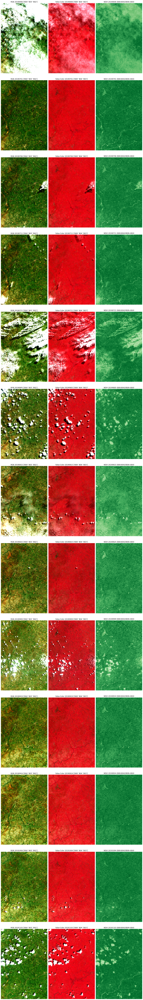

In [ ]:
# List of Sentinel-2 bands in the dataset

rgb = np.array(['B04','B03', 'B02'])
rgb_idx = [bands.index(b) for b in rgb]
rgb_stack = timeseries[:,:,:,rgb_idx]

false_color = np.array(['B08','B04', 'B03'])
false_color_idx = [bands.index(b) for b in false_color]
false_color_stack = timeseries[:,:,:,false_color_idx]

perc_rgb = np.percentile(rgb_stack.mean(2), (10, 90))
perc_false_color = np.percentile(np.median(false_color_stack,axis=2), (2, 98))

red = timeseries[:,:,:,bands.index("B04")]
nir = timeseries[:,:,:,bands.index("B08")]
ndvi = (red-nir) / (red+nir)

fig,axs = plt.subplots(len(dates),3,figsize=(15,len(dates)*8))

with tqdm(range(len(dates)),total=len(dates)) as pbar:
    for date_idx in pbar:

        ax = axs[date_idx,0]
        rgb_img = rgb_stack[date_idx]
        rgb_img = exposure.rescale_intensity(rgb_img, in_range=(perc_rgb[0],perc_rgb[1]))
        ax.imshow(rgb_img)
        ax.axis('off')
        dt = dates[date_idx]
        ax.set_title(f"RGB {dt} {rgb}")

        ax = axs[date_idx,1]
        false_color_img = false_color_stack[date_idx]
        false_color_img = exposure.rescale_intensity(false_color_img, in_range=(perc_false_color[0],perc_false_color[1]))
        ax.imshow(false_color_img)
        ax.axis('off')
        dt = dates[date_idx]
        ax.set_title(f"False-Color {dt} {false_color}")

        ax = axs[date_idx,2]
        ndvi_img = ndvi[date_idx]
        ax.imshow(ndvi_img, cmap="Greens_r")
        ax.axis('off')
        dt = dates[date_idx]
        ax.set_title(f"NDVI {dt} (B08-B04)/(B08+B04)")

fig.tight_layout()

## 2- Microsoft Torchgeo:

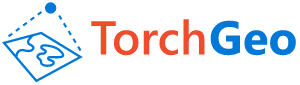

TorchGeo is a PyTorch domain library, similar to torchvision, providing datasets, samplers, transforms, and pre-trained models specific to geospatial data.



The goal of this library is to make it simple:

* for machine learning experts to work with geospatial data, and
* for remote sensing experts to explore machine learning solutions.

In the following example , we will download the NAIP(imagery) & chesapeake (segmentation labels) datasets , then combine then and make them ready for training using torchgeo:

In [ ]:
#Download NAIP(imagery) dataset - Training:
data_root = tempfile.gettempdir()
naip_root = os.path.join(data_root, "naip")
naip_url = (
    "https://naipeuwest.blob.core.windows.net/naip/v002/de/2018/de_060cm_2018/38075/"
)

#we choose specific tiles for our example:
tiles = [
    "m_3807511_ne_18_060_20181104.tif",
    "m_3807511_se_18_060_20181104.tif",
    "m_3807512_nw_18_060_20180815.tif"
]
for tile in tiles:
    download_url(naip_url + tile, naip_root)

naip = NAIP(naip_root)

  0%|          | 0/513332284 [00:00<?, ?it/s]

  0%|          | 0/521985441 [00:00<?, ?it/s]

  0%|          | 0/489865657 [00:00<?, ?it/s]

In [ ]:
#Download NAIP(imagery) dataset - Testing:
data_root_test = tempfile.gettempdir()
naip_root_test = os.path.join(data_root_test, "naip")
naip_url = (
    "https://naipeuwest.blob.core.windows.net/naip/v002/de/2018/de_060cm_2018/38075/"
)

#we choose specific tiles for our example:
tiles = [
    "m_3807512_sw_18_060_20180815.tif"
]
for tile in tiles:
    download_url(naip_url + tile, naip_root)

naip_test = NAIP(naip_root_test)

  0%|          | 0/484476647 [00:00<?, ?it/s]

In [ ]:
#Download chesapeake dataset and configure both coordinate reference systems (CRS) and resolution to match NAIP:
chesapeake_root = os.path.join(data_root, "chesapeake")
chesapeake = ChesapeakeDE(chesapeake_root, crs=naip.crs, res=naip.res, download=True)

  0%|          | 0/287350495 [00:00<?, ?it/s]

Labels:

0. No Data: Background values
1. Water: All areas of open water including ponds, rivers, and lakes
2. Wetlands: Low vegetation areas located along marine or estuarine regions
3. Tree Canopy: Deciduous and evergreen woody vegetation over 3-5 meters in height
4. Shrubland: Heterogeneous woody vegetation including shrubs and young trees
5. Low Vegetation: Plant material less than 2 meters in height including lawns
6. Barren: Areas devoid of vegetation consisting of natural earthen material
7. Structures: Human-constructed objects made of impervious materials
8. Impervious Surfaces: Human-constructed surfaces less than 2 meters in height
9. Impervious Roads: Impervious surfaces that are used for transportation
10. Tree Canopy over Structures: Tree cover overlapping impervious structures
11. Tree Canopy over Impervious Surfaces: Tree cover overlapping impervious surfaces
12. Tree Canopy over Impervious Roads: Tree cover overlapping impervious roads
13. Aberdeen Proving Ground: U.S. Army facility with no labels

In [ ]:
# perform intersection operation (only keep data which is present in both datasets):
dataset = naip & chesapeake
dataset_test = naip_test & chesapeake

In [ ]:
#Configure our sampler with number of crops (length) and crop_size (size):
sampler = RandomGeoSampler(dataset, size=128, length=1000)
sampler_test = RandomGeoSampler(dataset_test, size=128, length=500)

#configure Pytorch dataloader:
dataloader = DataLoader(dataset, sampler=sampler, collate_fn=stack_samples, batch_size=16)
dataloader_test = DataLoader(dataset_test, sampler=sampler_test, collate_fn=stack_samples, batch_size=16)

## 3- Training DL Segmentation model using Pytorch:

We will use a pre-trained UNet model from : [Link](https://github.com/qubvel/segmentation_models.pytorch)

then fine-tune it on our dataset using Dice loss.

In [ ]:
def acc(label, predicted):
    seg_acc = (y.cpu() == torch.argmax(pred_mask, axis=1).cpu()).sum() / torch.numel(y.cpu())
    return seg_acc

N_EPOCHS = 5

model = smp.Unet(
    encoder_name="resnet34",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=14,                      # model output channels (number of classes in your dataset)
)

if str(device) == 'cuda':
        print("model is cuda")
        model = model.cuda()

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = smp.losses.DiceLoss('multiclass', from_logits=True)

lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.5)
min_loss = torch.tensor(float('inf'))

os.makedirs('./saved_models', exist_ok=True)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

model is cuda


In [ ]:
import copy

plot_losses = []
scheduler_counter = 0
best_model = None

for epoch in range(N_EPOCHS):
  # training
  model.train()
  loss_list = []
  acc_list = []
  for batch_i, sample in enumerate(dataloader):
      x,y = sample["image"][:,:3,:,:], sample["mask"][:,:3,:,:]
      sample=None
      pred_mask = model(x.to(device).float())
      loss = criterion(pred_mask, y.to(device).type(torch.int64))

      optimizer.zero_grad()
      loss.backward()
      optimizer.step()
      loss_list.append(loss.cpu().detach().numpy())
      acc_list.append(acc(y,pred_mask).numpy())

      print(
          "\r[Epoch %d/%d] [Batch %d/%d] [Loss: %f (%f)]"
          % (
              epoch,
              N_EPOCHS,
              batch_i,
              len(dataloader),
              loss.cpu().detach().numpy(),
              np.mean(loss_list),
          )
      )
  scheduler_counter += 1
  # testing
  model.eval()
  val_loss_list = []
  val_acc_list = []
  for batch_i, sample in enumerate(dataloader_test):
      x,y = sample["image"][:,:3,:,:], sample["mask"][:,:3,:,:]
      sample=None
      with torch.no_grad():    
          pred_mask = model(x.to(device).float())  
      val_loss = criterion(pred_mask, y.to(device).type(torch.int64))
      val_loss_list.append(val_loss.cpu().detach().numpy())
      val_acc_list.append(acc(y,pred_mask).numpy())
      
  print(' epoch {} - loss : {:.5f} - acc : {:.2f} - val loss : {:.5f} - val acc : {:.2f}'.format(epoch, 
                                                                                                  np.mean(loss_list), 
                                                                                                  np.mean(acc_list), 
                                                                                                  np.mean(val_loss_list),
                                                                                                  np.mean(val_acc_list)))
  plot_losses.append([epoch, np.mean(loss_list), np.mean(val_loss_list)])

  compare_loss = np.mean(val_loss_list)
  is_best = compare_loss < min_loss
  if is_best == True:
    scheduler_counter = 0
    min_loss = min(compare_loss, min_loss)
    torch.save(model.state_dict(), './saved_models/unet_epoch_{}_{:.5f}.pt'.format(epoch,np.mean(val_loss_list)))
    best_model = copy.deepcopy(model)

  if scheduler_counter > 5:
      lr_scheduler.step()
      print(f"lowering learning rate to {optimizer.param_groups[0]['lr']}")
      scheduler_counter = 0

[Epoch 0/5] [Batch 0/63] [Loss: 0.474883 (0.474883)]
[Epoch 0/5] [Batch 1/63] [Loss: 0.606873 (0.540878)]
[Epoch 0/5] [Batch 2/63] [Loss: 0.589427 (0.557061)]
[Epoch 0/5] [Batch 3/63] [Loss: 0.584469 (0.563913)]
[Epoch 0/5] [Batch 4/63] [Loss: 0.655171 (0.582165)]
[Epoch 0/5] [Batch 5/63] [Loss: 0.571978 (0.580467)]
[Epoch 0/5] [Batch 6/63] [Loss: 0.560813 (0.577659)]
[Epoch 0/5] [Batch 7/63] [Loss: 0.495615 (0.567404)]
[Epoch 0/5] [Batch 8/63] [Loss: 0.553956 (0.565910)]
[Epoch 0/5] [Batch 9/63] [Loss: 0.514753 (0.560794)]
[Epoch 0/5] [Batch 10/63] [Loss: 0.482605 (0.553686)]
[Epoch 0/5] [Batch 11/63] [Loss: 0.539647 (0.552516)]
[Epoch 0/5] [Batch 12/63] [Loss: 0.485586 (0.547367)]
[Epoch 0/5] [Batch 13/63] [Loss: 0.538236 (0.546715)]
[Epoch 0/5] [Batch 14/63] [Loss: 0.469343 (0.541557)]
[Epoch 0/5] [Batch 15/63] [Loss: 0.470389 (0.537109)]
[Epoch 0/5] [Batch 16/63] [Loss: 0.535610 (0.537021)]
[Epoch 0/5] [Batch 17/63] [Loss: 0.537657 (0.537056)]
[Epoch 0/5] [Batch 18/63] [Loss: 0.528

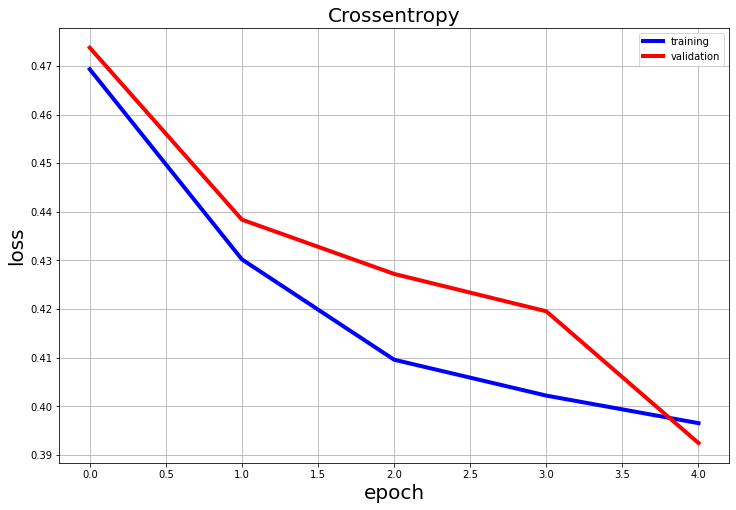

In [ ]:
# plot loss
plot_losses = np.array(plot_losses)
plt.figure(figsize=(12,8))
plt.plot(plot_losses[:,0], plot_losses[:,1], color='b', linewidth=4)
plt.plot(plot_losses[:,0], plot_losses[:,2], color='r', linewidth=4)
plt.title("Crossentropy", fontsize=20)
plt.xlabel('epoch',fontsize=20)
plt.ylabel('loss',fontsize=20)
plt.grid()
plt.legend(['training', 'validation']) # using a named size
plt.savefig('loss_plots.png')

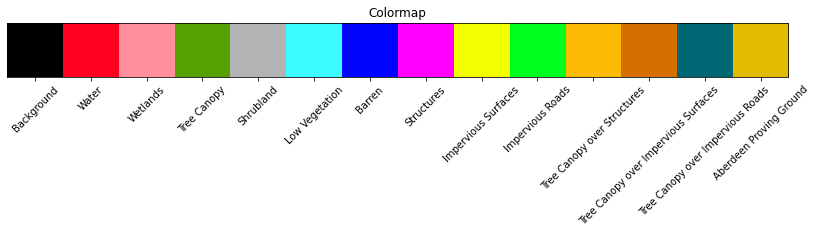

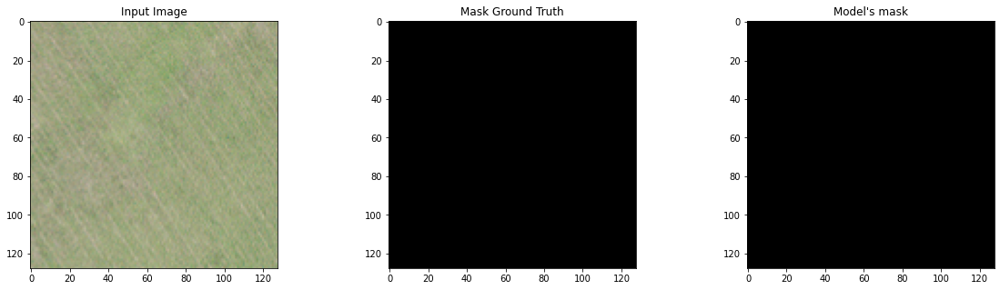

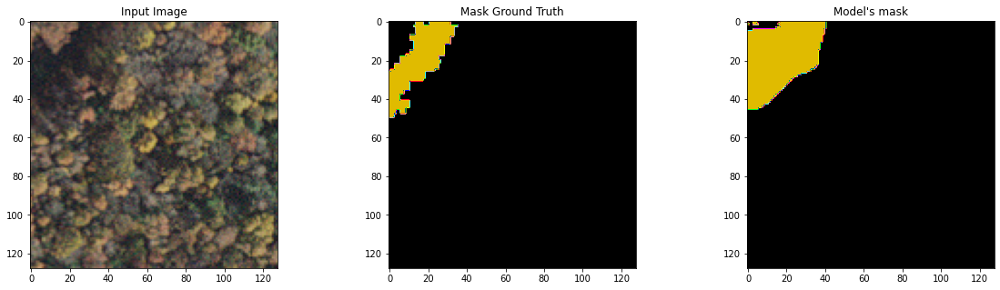

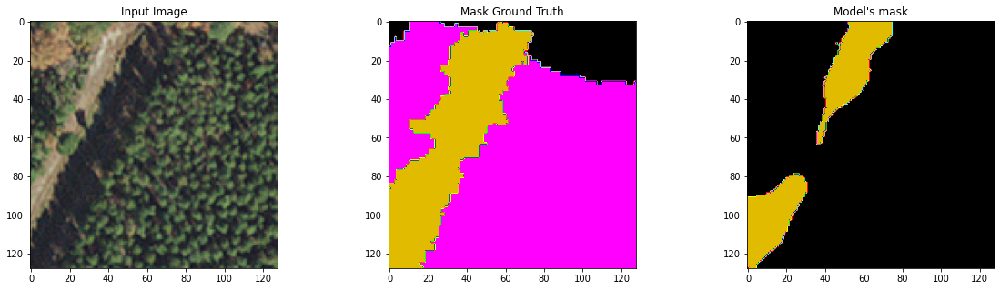

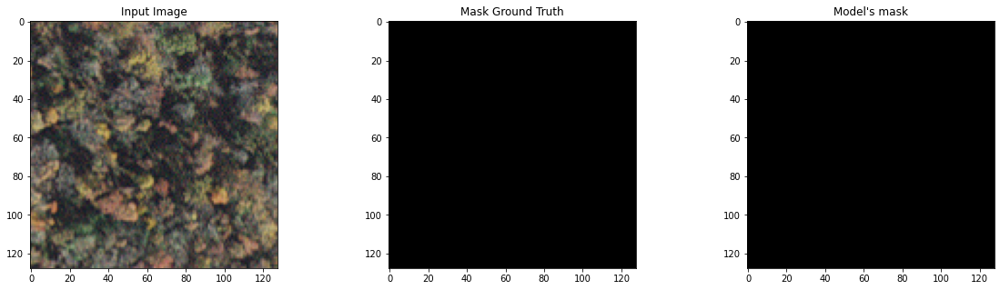

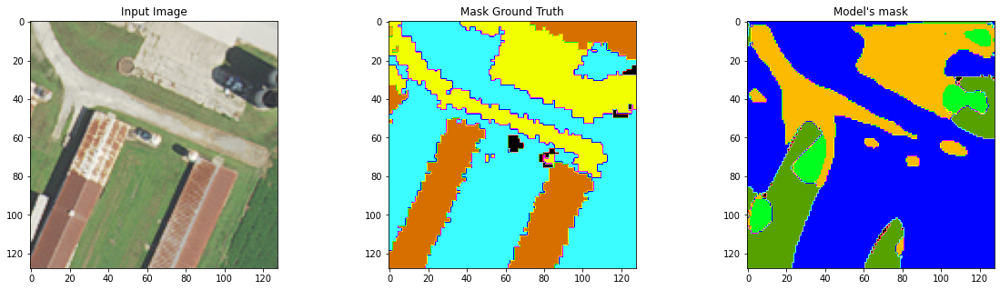

In [ ]:
# lets look at some samples
num_samples = 5
dataloader_plot = DataLoader(dataset_test, sampler=sampler, collate_fn=stack_samples, batch_size=1)

# Specify colors for each class using hex codes
class_colors = [
    "#000000", "#ff001e", "#ff8f9c", "#56a100",
    "#b3b3b3", "#3bfcff", "#0004ff", "#ff00ff",
    "#f2ff00", "#00ff1e", '#fcba03', '#d66f00',
    '#006875', '#e0bb00'
]

class_names = [
    'Background', 'Water', 'Wetlands', 'Tree Canopy',
    'Shrubland', 'Low Vegetation', 'Barren', 'Structures',
    'Impervious Surfaces', 'Impervious Roads', 'Tree Canopy over Structures',
    'Tree Canopy over Impervious Surfaces', 'Tree Canopy over Impervious Roads',
    'Aberdeen Proving Ground'
]

# Create a colormap with the given colors
colormap = ListedColormap(class_colors)

# Create a seperate figure and plot the colormap
plt.figure(figsize=(14, 1))
plt.imshow(np.arange(14).reshape(1, 14), cmap=colormap, aspect='auto', origin='lower')
plt.xticks(range(14), class_names, rotation=45, fontsize=10)
plt.yticks([])  # Hide y-axis ticks
plt.title("Colormap")
plt.show()

#iterate over samples and display them:
for i in range(num_samples):
    plt.figure(figsize=(20, 5))
    sample = next(iter(dataloader_plot))
    model.eval()
    output = model(sample["image"][:,:3,:,:].float().to(device)).detach().type(torch.int64)
    plt.subplot(1,3,1)
    plt.title("Input Image")
    plt.imshow(sample["image"][:,:3,:,:].squeeze().permute(1, 2, 0).type(torch.int64)) # for visualization we have to transpose back to HWC
    plt.subplot(1,3,2)
    plt.title("Mask Ground Truth")
    plt.imshow(sample["mask"][:,:3,:,:].squeeze().type(torch.int64), cmap=colormap)  # for visualization we have to remove 3rd dimension of mask
    plt.subplot(1,3,3)
    plt.title("Model's mask")
    plt.imshow(output.argmax(dim=1).squeeze().type(torch.int64).cpu(), cmap=colormap)  # for visualization we have to remove 3rd dimension of mask
    # cbar = plt.colorbar(ticks=range(14), format='%1i', cmap=colormap)
    # cbar.ax.set_yticklabels(class_names)
    
    plt.show()